# Project 4, Partial Differential Equations
**Devon DeJohn** | PHY 4611 | March 30, 2019

> This project explores the Forward Time Centered Space method for solving the heat/diffusion equation in a 1D rod. The bare-bones FTCS method is said to be "conditionally stable", depending on the time step chosen.

## 6.1 PDE Solution Check

> Show that 
>
> $$T_G(x,t) = \frac{1}{\sigma (t) \sqrt{2\pi}} exp \bigg{[} \frac{-(x - x_0)^2}{2 \sigma ^2(t)} \bigg{]}$$
>
> is a solution to the diffusion PDE. Where $\sigma(t) = \sqrt{2 \kappa t}$.

See attached for answer.

## 6.3 Dirichlet Forward Time Centered Space

> Run the `dftcs` program with $N=61$ and a variety of values for $\tau$ between $10^{-5}$ and $10^{-3}$. For $\tau=1.0\times 10^{-4}$, try a variety of values for $N$. What do you observe?

`FTCS` becomes unstable for $\tau > 1.35\times 10^{-4}$. Unfortunately I can't even run the alogrithm past that as the program crashes. The crashing seems to have more to do with the contour map plotting however, which I believe is bugged right now (as contour level labels aren't showing either). I am also unable to plot for $N=100$ and above with the timestep fixed at $1.0\times 10^{-4}$.

In [2]:
plot_temps(heat_eq(1e-5, 61, mthd=dftcs), 0.15)

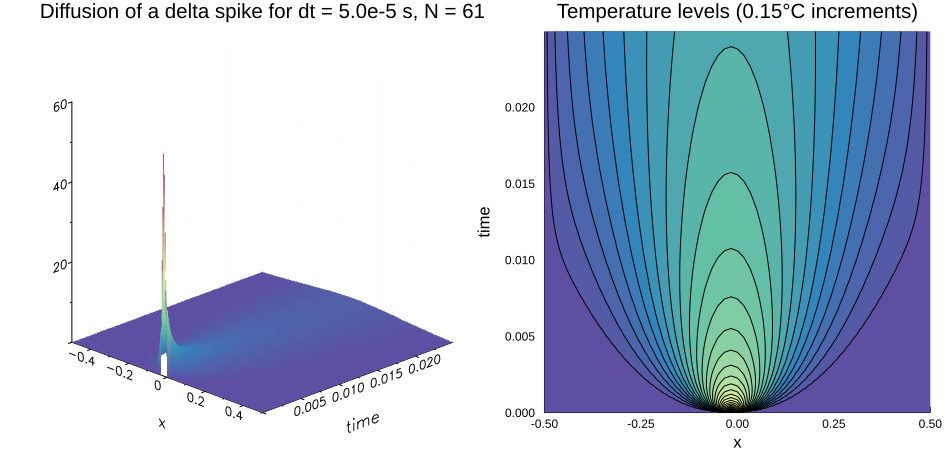

In [3]:
plot_temps(heat_eq(5e-5, 61, mthd=dftcs), 0.15)

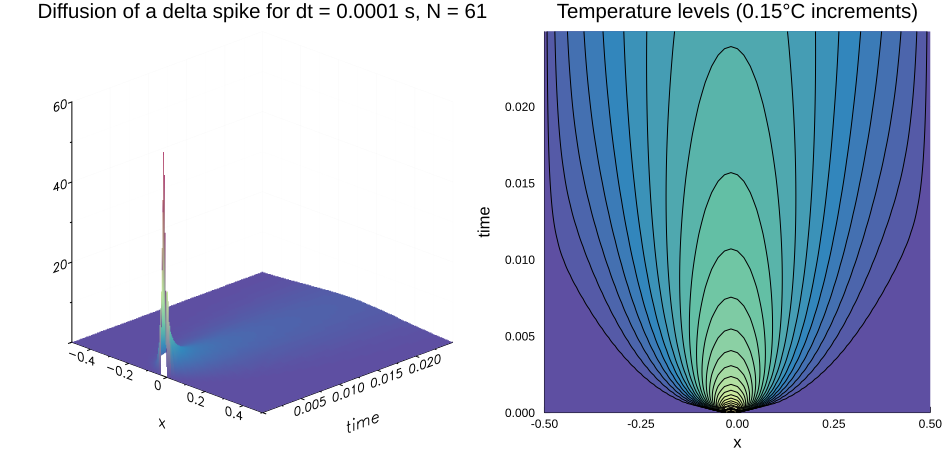

In [4]:
plot_temps(heat_eq(1e-4, 61, mthd=dftcs), 0.15)

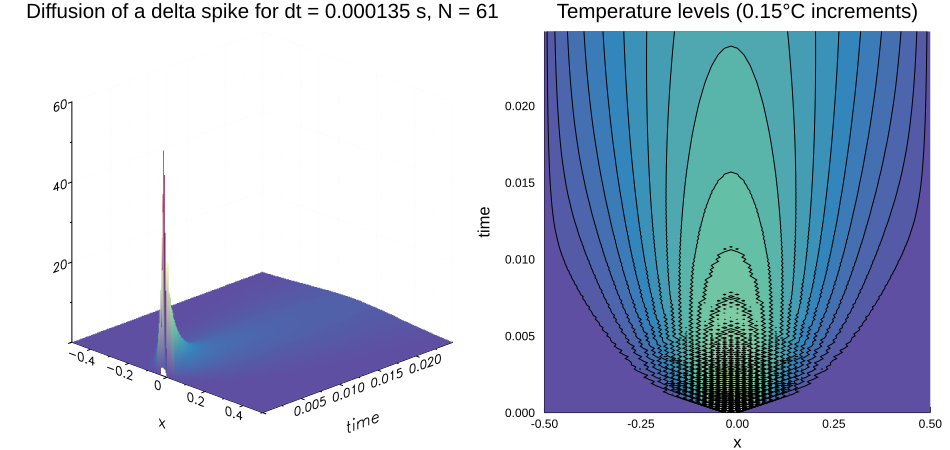

In [5]:
plot_temps(heat_eq(1.35e-4, 61, mthd=dftcs), 0.15)

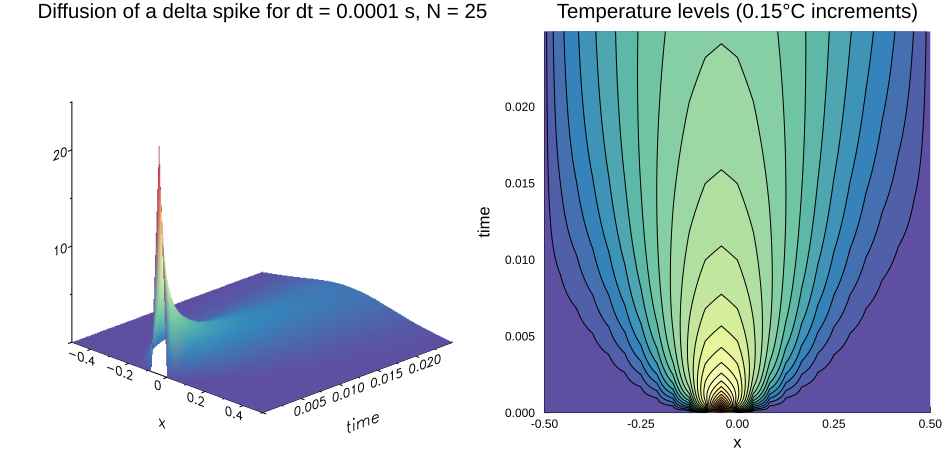

In [6]:
plot_temps(heat_eq(1e-4, 25, mthd=dftcs), 0.15)

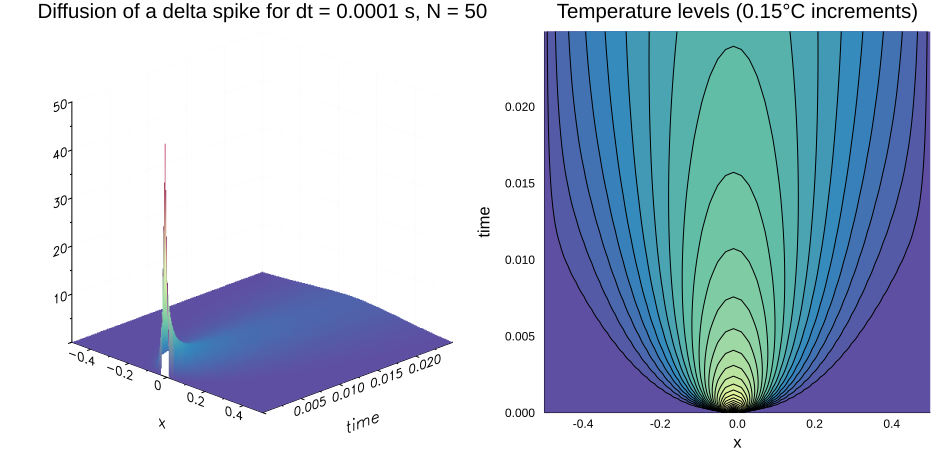

In [7]:
plot_temps(heat_eq(1e-4, 50, mthd=dftcs), 0.15)

## 6.6 Thermal Insulator

> Add code to replace the Dirichlet boundary conditions with the Neumann boundary conditions for a thermal insulator.

Pretty straightforward. Since flux is zero at the boundaries, heat will build up at the edges. After enough time, the rod will settle into the steady state solution wherein the temperature distribution is uniform. It's not all that easy to see with the delta spikes however, as the average temperature is quite low. I made an animated gif of a random temperature distribution and the steady state temperature is clearly approached after only about 0.03 seconds. Of course this is asymptotic behavior, so obviously we can't show the behavior for large time values, as the simulation would take too long (and not much would change).

The solution for the initial condition $T(x, 0) = \delta(x)$ is $$\sum_{n=-\infty}^{\infty} \frac{1}{2 \sqrt{\pi k t}} \text{exp} \bigg{[} \frac{-(x + nL)^2}{4 k t} \bigg{]}$$

The solution for the initial condition $T(x, 0) = \delta(x - L/4)$ is $$\sum_{n=-\infty}^{\infty} \frac{1}{2 \sqrt{\pi k t}} \text{exp} \bigg{[} \frac{-(x + L(n - 1/4))^2}{4 k t} \bigg{]}$$

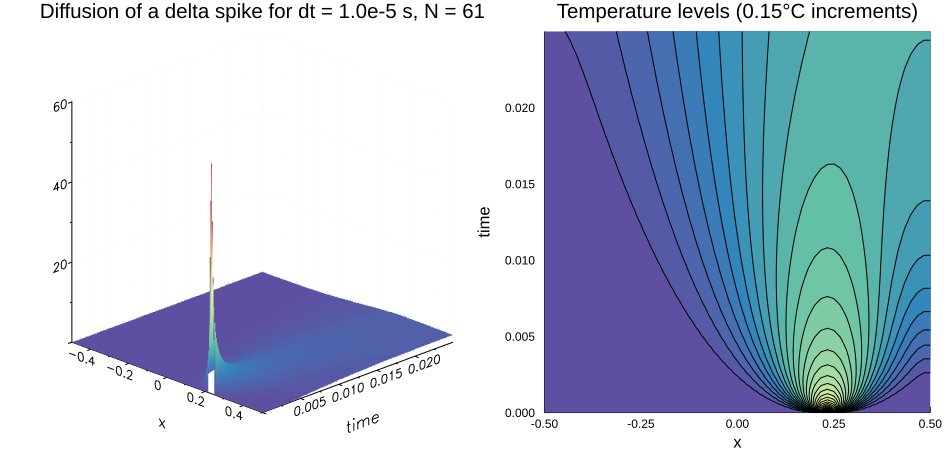

In [8]:
plot_temps(heat_eq(1e-5, 61, mthd=nftcs, offset=1/4), 0.15)

## 6.7 Periodic Boundary Conditions

> Add code to allow for periodic boundary conditions.

This is where I deviated from Garcia's suggestions. He writes that we should set $T_0^n = T_{N-2}^n$ and $T_{N-1}^n = T_1^n$ but when I implemented this suggestion, the graphs didn't look right. Instead, I simply extended the `FTCS` method to "wrap" around the ends of the bar, so that the entire length of the bar is continuously evaluated using the `FTCS` method. The results look much more reasonable, whereas previous results did not look periodic.

In [9]:
plot_temps(heat_eq(1e-5, 61, mthd=pftcs, offset=1/4), 0.15)

## 6.9 DuFort-Frankel

> Use the DuFort-Frankel Scheme for solving the diffusion equation.

I initially had some issues with this, but was able to find an error in my code. Implementing this was just as easy as the other methods. However, I'm pretty disappointed with the results. There's obviously value in having access to an "unconditionally stable" method for solving the diffusion equation, but the way `DFF` method oscillates around the exact solution makes it look as though the results aren't particularly accurate. I found that timestep values less than $10^{-6}$ produced good looking results, but any larger than that and the oscillations grew too large and the plots became an unreadable mess.

In [10]:
plot_temps(heat_eq(1e-5, 61, mthd=dffm),0.25)

In [11]:
plot_temps(heat_eq(1e-6, 61, mthd=dffm), 0.25)

![all_three](https://i.imgur.com/0t5iFfy.gif)
![sine_temps](https://i.imgur.com/CDeUlhZ.gif)

In [1]:
using Plots
gr()

# Length of rod and diffusivity constants.
const L = 1.
const diff = 1.

# Dirichlet Forward Time Centered Space (ends fixed at 0°C).
function dftcs(x...)
    temps, n, steps, k = x

    for i in 2:steps
#         temps[i,1] = 0
#         temps[i,n] = 0
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
    end
    return temps
end

# Neumann Forward Time Centered Space (zero flux at ends).
function nftcs(x...)
    temps, n, steps, k = x
    
    for i in 2:steps
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
        temps[i,1] = temps[i,2]
        temps[i,n] = temps[i,n-1]
    end
    return temps
end

# Periodic Forward Time Centered Space (flux equal at both ends).
function pftcs(x...)
    temps, n, steps, k = x
    
    for i in 2:steps
        temps[i,1] = temps[i-1,1] + k*(temps[i-1,n] + temps[i-1,2] - 2*temps[i-1,1])
        
        for j in 2:(n-1)
            temps[i,j] = temps[i-1,j] + k*(temps[i-1,j-1] + temps[i-1,j+1] - 2*temps[i-1,j])
        end
        
        temps[i,n] = temps[i-1,n] + k*(temps[i-1,n-1] + temps[i-1,1] - 2*temps[i-1,n])
    end
    return temps
end

# DuFort-Frankel Method (not working).
function dffm(x...)
    temps, n, steps, k, t, h = x
    s = 2*diff*t/h^2
    
    # First iteration (DFFM starter).
    for j in 2:(n-1)
        temps[2,j] = temps[1,j] + (diff*1e-6/h^2)*(temps[1,j-1] + temps[1,j+1] - 2*temps[1,j])
    end
    
    # DFFM
    for i in 3:steps
        for j in 2:(n-1)
            temps[i,j] = ((1-s)/(1+s)) * temps[i-2,j] + (s/(1+s)) * (temps[i-1,j+1] + temps[i-1,j-1])
        end
    end
    
    return temps
end

# Compute temperature in 1D rod of length 'const L' and diffusivity 'const diff'.
# Where t = timestep, n = number of grid points, mthd = dftcs, nftcs, pftcs, dffm.
# (Dirichlet, Neumann, periodic, DuFort-Frankel)
function heat_eq(t, n; mthd, offset=1/2)
    # Grid spacing.
    h = L/(n-1)

    # FTCS coefficient.
    k = diff*t/h^2

    # Initial conditions; integrate to t=0.025 seconds.
    steps = Int(round(0.025/t))
    xi = Int(ceil(offset*n))
    temps = zeros(steps, n)
    temps[1, n-xi] = 1.0/h

    # x- and time-values for plotting
    xvals = [-L/2 + h*i for i in 0:(n-1)]
    tvals = [t*i for i in 0:(steps-1)]

    return (mthd(temps, n, steps, k, t, h), xvals, tvals, n, t)
end

function plot_temps(dat, inc=0.1)
    temp, x, t, nstep, tstep = dat
    ttl = string("Diffusion of a delta spike for dt = ", string(tstep), " s, N = ", string(nstep))
    p1=surface(x, t, temp, title=ttl,
            xlabel=:"x", ylabel=:"time", zlabel=:"T(x,t)", 
            color=:Spectral_r, colorbar=false,
            st=:surface, camera=(45,45))
    p2=contour(x, t, temp, title="Temperature levels ($(inc)°C increments)",
            xlabel=:"x", ylabel=:"time", 
            levels=[i^2 for i in 0.:inc:sqrt(maximum(temp))],
            color=:Spectral_r, colorbar=false,
            st=:contourf, contour_labels=true)
    plot(p1, p2, layout=2, size=(950,450))
end;

#——————————————————————————————————————————————————————————————————————————————————————————————————————————————————————#

# # GIF-MAKING STUFF
# function rand_eq(t, n; mthd)
#     # Grid spacing.
#     h = L/(n-1)

#     # FTCS coefficient.
#     k = diff*t/h^2

#     # Initial conditions; integrate to t=0.025 seconds.
#     steps = Int(round(0.025/t))
#     temps = zeros(steps, n)

#     # x- and time-values for plotting
#     xvals = [-L/2 + h*i for i in 0:(n-1)]
#     tvals = [t*i for i in 0:(steps-1)]
    
#     for (i,x) in enumerate(xvals)
#         temps[1, i] = 6*cos(7*x)*sin(-17*x) / (cos(13*x) + 3*sin(-37*x)^3 + 5) + 3
#     end

#     return (mthd(temps, n, steps, k, t, h), xvals, tvals)
# end

# function all_three()
#     ddat = heat_eq(1e-5, 41, mthd=dftcs, offset=1/8)
#     ndat = heat_eq(1e-5, 41, mthd=nftcs, offset=1/8)
#     pdat = heat_eq(1e-5, 41, mthd=pftcs, offset=1/8)

#     dtemp, dx, t = ddat
#     ntemp, nx, nt = ndat
#     ptemp, px, pt = pdat
#     max_T = maximum(dtemp)/2
#     min_x = minimum(dx)
#     max_x = maximum(dx)

#     anim = @animate for i=1:5:Int(round(size(dtemp,1)))
#         dt = "$(round(t[i], digits=4))"
#         if length(dt) < 6
#             dt = rpad(dt, 6, "0")
#         end
#         ttl = string("Temperature from a delta spike at L/8 at time t = ", dt, " s")
#         plot(size=(900,450), title=ttl, xlabel=:"x", ylabel=:"T(x)", xlims=(min_x, max_x), ylims=(0.,max_T))
#         plot!(dx, dtemp[i, :], lw=4, label=:"Dirichlet")
#         plot!(nx, ntemp[i, :], lw=4, label=:"Neumann")
#         plot!(px, ptemp[i, :], lw=4, label=:"Periodic")
#     end every 5
#     gif(anim, "all_three.gif")
# end

# function rand_temps()
#     temp1, x1, t1 = rand_eq(1e-6, 321, mthd=dftcs)
#     temp2, x2, t2 = rand_eq(1e-6, 321, mthd=nftcs)
#     temp3, x3, t3 = rand_eq(1e-6, 321, mthd=pftcs)
    
#     max_T = 1.25*maximum(temp1)
#     min_T = minimum(temp1)
#     min_x = minimum(x1)
#     max_x = maximum(x1)

#     anim = @animate for i=1:30:Int(round(size(temp1,1)))
#         dt = "$(round(t1[i], digits=4))"
#         if length(dt) < 6
#             dt = rpad(dt, 6, "0")
#         end
#         ttl = string("Sinusoidal temperature distribution at time t = ", dt, " s")
#         plot(size=(900,450), xlabel=:"x", ylabel=:"T(x)", xlims=(min_x, max_x), ylims=(min_T,max_T), title=ttl)
#         plot!(x1, temp1[i, :], lw=4, label=:"Dirichlet")
#         plot!(x2, temp2[i, :], lw=4, label=:"Neumann")
#         plot!(x3, temp3[i, :], lw=4, label=:"Periodic")
#         plot!(x1, temp1[1, :], lw=4, alpha=0.5, label=:"Initial")
#     end every 5
#     gif(anim, "rand_temps.gif")
# end;